# Building a Book Recommender System using Python

## Objective

Recommender systems have become a part of daily life for users of Amazon and Netflix and even social media. While some sites might use these systems to improve the customer experience (if you liked movie A, you might like movie B) or increase sales (customers who bought product C also bought product D), others are focused on customized advertising and suggestive marketing. As a book lover and former book store manager, I have always wondered where I can find good book recommendations that are both personalized to my interests and also capable of introducing me to new authors and genres. The purpose of this project is to create just such a recommender system (RS).

### Collaborative Filtering vs. Content Filtering

If an RS suggests items to a user based on past interactions between users and items, that system is known as a Collaborative Filtering system. In these recommendation engines, a user-item interactions matrix is created such that every user and item pair has a space in the matrix. That space is either filled with the user's rating of that item or it is left blank. This can be used for matrix factorization or nearest neighbor classification, both of which will be addressed when we develop our models. The important thing to remember with collaborative filtering is that user id, item id, and rating are the only fields required. Collaborative models can be user-based or item-based but I will work primarily with item-based modeling because I am interested in finding new books to read, not in finding other users like myself.

Content filtering, on the other hand, focuses exclusively on either the item or the user and does not need any information about interactions between the two. Instead, content filtering calculates the similarity between items using attributes of the items themselves. For my book data, I will use book reviews and text analysis to determine which books are most similar to books that I like and thus which books should be recommended.

References:

https://medium.com/@chhavi.saluja1401/recommendation-systems-made-simple-b5a79cac8862
https://stackabuse.com/creating-a-simple-recommender-system-in-python-using-pandas/
https://towardsdatascience.com/collaborative-filtering-based-recommendation-systems-exemplified-ecbffe1c20b1
https://towardsdatascience.com/introduction-to-recommender-systems-6c66cf15ada
https://towardsdatascience.com/recommendation-systems-models-and-evaluation-84944a84fb8e
https://towardsdatascience.com/various-implementations-of-collaborative-filtering-100385c6dfe0

## Data

While there are many book datasets available to use, I decided to work with Goodreads Book data. There are several full Goodreads data sets available at the [UCSD Book Graph site](https://sites.google.com/eng.ucsd.edu/ucsdbookgraph/home) and I initially worked with this data to analyze metadata for books, authors, series, genres, reviews, and the interactions between users and items. Once I began building the models, I quickly realized that my dataset was too large. Rather than limit myself to just one genre, I chose to use the [Goodreads 10k data set](https://www.kaggle.com/zygmunt/goodbooks-10k/version/4). This data set contains book metdata, ratings, book tags, and book shelves. 

For full code, view the following files in this github:

[EDA - full Goodreads authors, works, series, genres, interactions.ipynb](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Code/EDA%20-%20full%20Goodreads%20authors%2C%20works%2C%20series%2C%20genres%2C%20interactions.ipynb)
    
[Data prep - full Goodreads loading files, statistics, distributions.ipynb](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Code/Data%20prep%20-%20full%20Goodreads%20loading%20files%2C%20statistics%2C%20distributions.ipynb)


### Collection, Cleaning and Analysis

##### Full Goodreads Dataset

In [3]:
import gzip
def parse(path):
    g = gzip.open(path, 'r')
    for l in g:
        yield eval(l)

In [4]:
books = parse('Unused data/goodreads_books.json.gz')
next(books)

{'isbn': '0312853122',
 'text_reviews_count': '1',
 'series': [],
 'country_code': 'US',
 'language_code': '',
 'popular_shelves': [{'count': '3', 'name': 'to-read'},
  {'count': '1', 'name': 'p'},
  {'count': '1', 'name': 'collection'},
  {'count': '1', 'name': 'w-c-fields'},
  {'count': '1', 'name': 'biography'}],
 'asin': '',
 'is_ebook': 'false',
 'average_rating': '4.00',
 'kindle_asin': '',
 'similar_books': [],
 'description': '',
 'format': 'Paperback',
 'link': 'https://www.goodreads.com/book/show/5333265-w-c-fields',
 'authors': [{'author_id': '604031', 'role': ''}],
 'publisher': "St. Martin's Press",
 'num_pages': '256',
 'publication_day': '1',
 'isbn13': '9780312853129',
 'publication_month': '9',
 'edition_information': '',
 'publication_year': '1984',
 'url': 'https://www.goodreads.com/book/show/5333265-w-c-fields',
 'image_url': 'https://images.gr-assets.com/books/1310220028m/5333265.jpg',
 'book_id': '5333265',
 'ratings_count': '3',
 'work_id': '5400751',
 'title': '

In [5]:
reviews = parse('Unused data/goodreads_reviews_dedup.json.gz')
next(reviews)

{'user_id': '8842281e1d1347389f2ab93d60773d4d',
 'book_id': '24375664',
 'review_id': '5cd416f3efc3f944fce4ce2db2290d5e',
 'rating': 5,
 'review_text': "Mind blowingly cool. Best science fiction I've read in some time. I just loved all the descriptions of the society of the future - how they lived in trees, the notion of owning property or even getting married was gone. How every surface was a screen. \n The undulations of how society responds to the Trisolaran threat seem surprising to me. Maybe its more the Chinese perspective, but I wouldn't have thought the ETO would exist in book 1, and I wouldn't have thought people would get so over-confident in our primitive fleet's chances given you have to think that with superior science they would have weapons - and defenses - that would just be as rifles to arrows once were. \n But the moment when Luo Ji won as a wallfacer was just too cool. I may have actually done a fist pump. Though by the way, if the Dark Forest theory is right - and I

As is clear from these counts, the full Goodreads data is very, very large. 
![Full Goodreads counts.png](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Full%20Goodreads%20counts.png)

The interactions file lists each user and each book that users have marked as shelved (to be read later), read, rated, and reviewed. 
![Goodreads interactions counts.png](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Log-log%20plots%20of%20interactions.png)

When visualizating the log-log plot of user/item distributions, both plots appear to follow Zipf's law. Zipf's law is typically used in text analysis and states that the frequency of any word is inversely proportional to its rank in the frequency table. In the case of the Goodreads data, it simply means that many of the book entries are for the same small number of books and from the same small number of users. More information on Zipf's Law can be found [here](https://en.wikipedia.org/wiki/Zipf%27s_law).

![Log-log plots of interactions.png](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Plot%20of%20dist%20of%20users.png)

The histogram below shows the distribution of the ratings in the interactions file. The scatterplot also indicates a clear relationship between the number of books read by a user and the number of books reviewed by the same user.

![Hist and scatterplot](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Hist%20and%20scatterplot.png)

I conducted similar analysis of the author file, recognizing that there is quite a bit of overlap between authors who receive high ratings on average and authors that have a large number of text reviews.

![Author plots](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Author%20plots.png)


The genres can be plotted in a pie chart where it becomes clear that fiction is the most prevelant genre. One think to note is that books can be tagged with multiple genres.

![Pie chart of genres](https://github.com/Reinalynn/Building-a-Book-Recommendation-System-using-Python/blob/master/Images/Pie%20chart%20of%20genres.png)

##### Goodreads 10k dataset

In [6]:
import surprise
import numpy as np
import pandas as pd
import pandas_profiling
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

books10k = pd.read_csv('Data/books10k.csv')
ratings10k = pd.read_csv('Data/ratings10k.csv')

In [38]:
pandas_profiling.ProfileReport(books10k)

In [39]:
pandas_profiling.ProfileReport(ratings10k)

### Feature Selection and Engineering
For collaborative filtering, the primary features necessary are user_id, book_id, and ratings. These were already present in the Goodreads 10k dataset and could be found in the ratings10k file.

For content filtering, it was important to include all of the variables that might be used to determine which items are similar to one another. To prepare for this, I had to create a new feature that contained relevant text for each book and then conduct text analysis on that feature. I was prepared to use the review text from each book for this, but I did try out a few different text features. From simplest to most complex, I used book tags only, keywords only, review text only, cleaned review text, and then a full text field that contained review text + title + authors + publication date. As expected, the best results were found with the full text field.

#### Text Analysis
In order to prep my text data for the content based RS, I followed these steps:
1. use generator to list reviews
2. merge reviews with books
3. books have multiple reviews - concat all review_text by book title and group 
4. clean text (this step is optional and I determined it was best to skip)
5. add back in book metadata because I had mistakenly dropped too many columns in step 2 (because of large data file)

In [22]:
# final dataset with full book metadata, review_text, and full_text (not cleaned/stemmed/lemmatized)
reviews_full = pd.read_csv('Data/reviews10k_grouped_full.csv')
reviews_full.head(10)

,book_id,goodreads_book_id,best_book_id,work_id,books_count,isbn,isbn13,original_publication_year,title,language_code,...,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,authors_y,original_title_y,review_text,full_text
0,1,2767052,2767052,2792775,272,439023483,9.780439e+12,2008.0,"The Hunger Games (The Hunger Games, #1)",eng,...,155254,66715,127936,560092,1481305,2706317,Suzanne Collins,The Hunger Games,I cracked and finally picked this up. Very enj...,"2008.0 The Hunger Games (The Hunger Games, #1)..."
1,2,3,3,4640799,491,439554934,9.780440e+12,1997.0,Harry Potter and the Sorcerer's Stone (Harry P...,eng,...,75867,75504,101676,455024,1156318,3011543,"J.K. Rowling, Mary GrandPré",Harry Potter and the Philosopher's Stone,Tuve el gusto de leerlo antes de que saliera l...,1997.0 Harry Potter and the Sorcerer's Stone (...
2,3,41865,41865,3212258,226,316015849,9.780316e+12,2005.0,"Twilight (Twilight, #1)",en-US,...,95009,456191,436802,793319,875073,1355439,Stephenie Meyer,Twilight,"If I was 15, I would have LOVED this. It wasn'...","2005.0 Twilight (Twilight, #1) en-US Stephenie..."
3,4,2657,2657,3275794,487,61120081,9.780061e+12,1960.0,To Kill a Mockingbird,eng,...,72586,60427,117415,446835,1001952,1714267,Harper Lee,To Kill a Mockingbird,"Still relevant and beautiful.,R.I.P. Ms. Harpe...",1960.0 To Kill a Mockingbird eng Harper Lee To...
4,5,4671,4671,245494,1356,743273567,9.780743e+12,1925.0,The Great Gatsby,eng,...,51992,86236,197621,606158,936012,947718,F. Scott Fitzgerald,The Great Gatsby,I read this classic twice in high school. Its ...,1925.0 The Great Gatsby eng F. Scott Fitzgeral...
5,6,11870085,11870085,16827462,226,525478817,9.780525e+12,2012.0,The Fault in Our Stars,eng,...,140739,47994,92723,327550,698471,1311871,John Green,The Fault in Our Stars,So.. well I know everyone's obsessed with this...,2012.0 The Fault in Our Stars eng John Green T...
6,7,5907,5907,1540236,969,618260307,9.780618e+12,1937.0,The Hobbit,en-US,...,37653,46023,76784,288649,665635,1119718,J.R.R. Tolkien,The Hobbit or There and Back Again,Couldn't finish it. I was 5/6 of the way done ...,1937.0 The Hobbit en-US J.R.R. Tolkien The Hob...
7,8,5107,5107,3036731,360,316769177,9.780317e+12,1951.0,The Catcher in the Rye,eng,...,44920,109383,185520,455042,661516,709176,J.D. Salinger,The Catcher in the Rye,"Certainly not his best, but it's Salinger so I...",1951.0 The Catcher in the Rye eng J.D. Salinge...
8,9,960,960,3338963,311,1416524797,9.781417e+12,2000.0,"Angels & Demons (Robert Langdon, #1)",en-CA,...,25112,77841,145740,458429,716569,680175,Dan Brown,Angels & Demons,"A quick read, and probably better than The Da ...","2000.0 Angels & Demons (Robert Langdon, #1) e..."
9,10,1885,1885,3060926,3455,679783261,9.780680e+12,1813.0,Pride and Prejudice,eng,...,49152,54700,86485,284852,609755,1155673,Jane Austen,Pride and Prejudice,This great classic's color paints vivid pictur...,1813.0 Pride and Prejudice eng Jane Austen Pri...


tried several different types of text:
1. regular cleaned review text
2. book tags
3. keywords (identify top 5 keywords for each book)
4. regular review text
5. full text (review text + title + authors + publication dates)

In [23]:
# build a wordcloud from full_text
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import itertools

review_text = itertools.islice(ds.full_text, 5000)
review_text = list(review_text)

bunch_text = " ".join(str(text) for text in review_text[:1500])
stopwords = set(STOPWORDS)
wordcloud = WordCloud(stopwords=stopwords, background_color="white", colormap= "magma").generate(bunch_text)

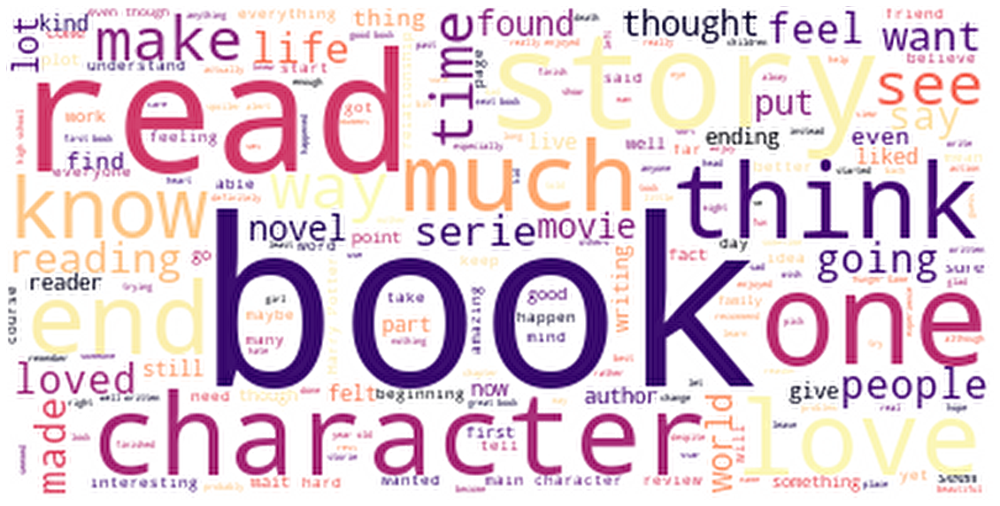

In [49]:
plt.figure(figsize=[20,20])
plt.imshow(wordcloud, interpolation="sinc")
plt.axis("off")
plt.show()

## Building and Tuning the Models
### Collaborative Filtering
In Collaborative Filtering, the model is often predicting the user's rating for a given book. Because of this, test and train sets can be created and root mean square error (RMSE) can be used to calculate the error rate of the model (difference between actual rating and predicted rating). The lower the RMSE, the lower the error and the more accurate the model.

#### PySpark
The PySpark package in Python uses the Alternating Least Squares (ALS) method to build recommendation engines. ALS is a matrix factorization running in a parallel fashion and is built for larger scale problems. PySpark was created to support the collaboration of Apache Spark and Python. Because ALS uses matrix factorization, it is comparable to the SVD and SVD++ algorithms in the Surprise package.


calculated sparcity
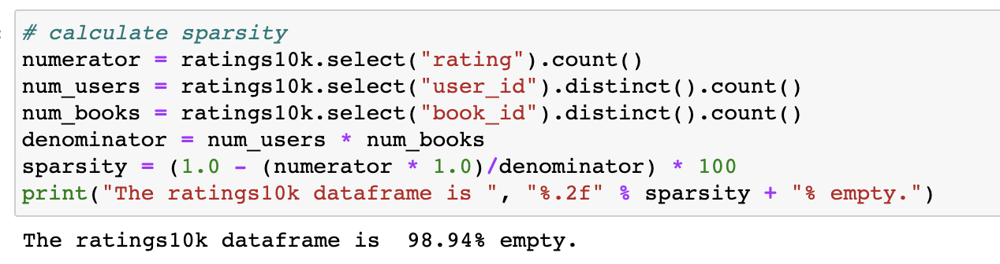

took a long time to build, but model had very good accuracy with rmse = 0.396 on full data
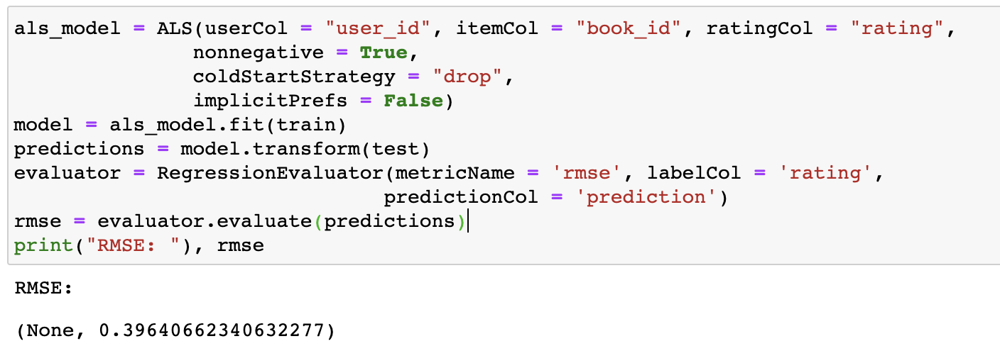
tuned the model to get rmse as low as 0.362
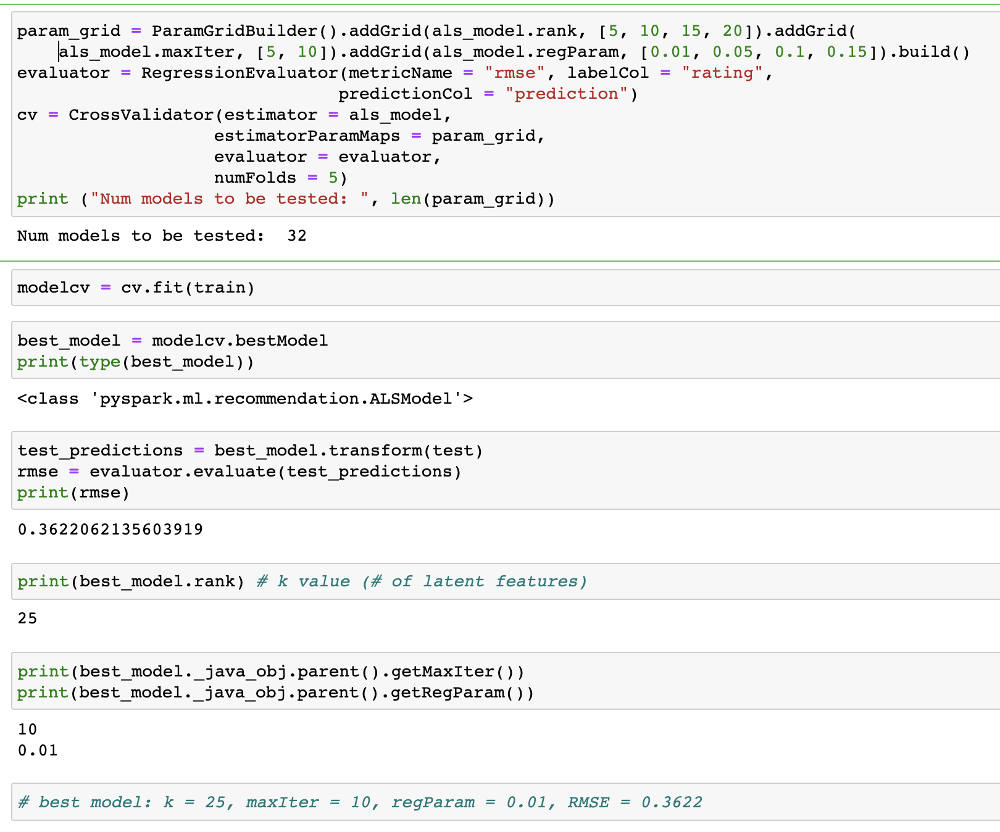

#### Pandas corrwith (pearsonR correlation)
Some Collaborative Filtering RS are built using a memory based method such as correlation. These models are very easy to build and interpret but the accuracy cannot be measured because the model is simply grouping like items together. The corrwith function in Pandas uses PearsonR's correlation method to output a nice list of recommendations when a book is input:


<img src = "attachment:image.png" width = "400">
<img src = "attachment:image-2.png" width = "400">

#### Surprise
The Surprise package in Python is newer but provided all the tools I needed to test out multiple algorithms for Collaborative Filtering and then guided me through tuning the parameters and cross validating to determine the optimal model. In order to this, I chose three versions of the data to analyze. First, I looked at the most popular books only, filtering down to those with at least 20 book ratings and at least 50 user ratings. I then created a list of midlist books by filtering down to 2 book rating and 20 user ratings. Finally, I used the full list to include books that have as little as 1 book rating and 1 user rating.


In [7]:
from surprise import Reader
from surprise import Dataset
from surprise import NormalPredictor
from surprise import KNNBasic
from surprise import KNNWithMeans
from surprise import KNNWithZScore
from surprise import KNNBaseline
from surprise import SVD
from surprise import BaselineOnly
from surprise import SVDpp
from surprise import NMF
from surprise import SlopeOne
from surprise import CoClustering
from surprise import accuracy
from surprise.accuracy import rmse
from surprise.model_selection import train_test_split, cross_validate, GridSearchCV

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

reader = Reader(rating_scale=(1, 5))
data = surprise.Dataset.load_from_df(ratings10k,reader)

build out results for multiple algorithms to see which would be best for this data
<table><tr>
<td> 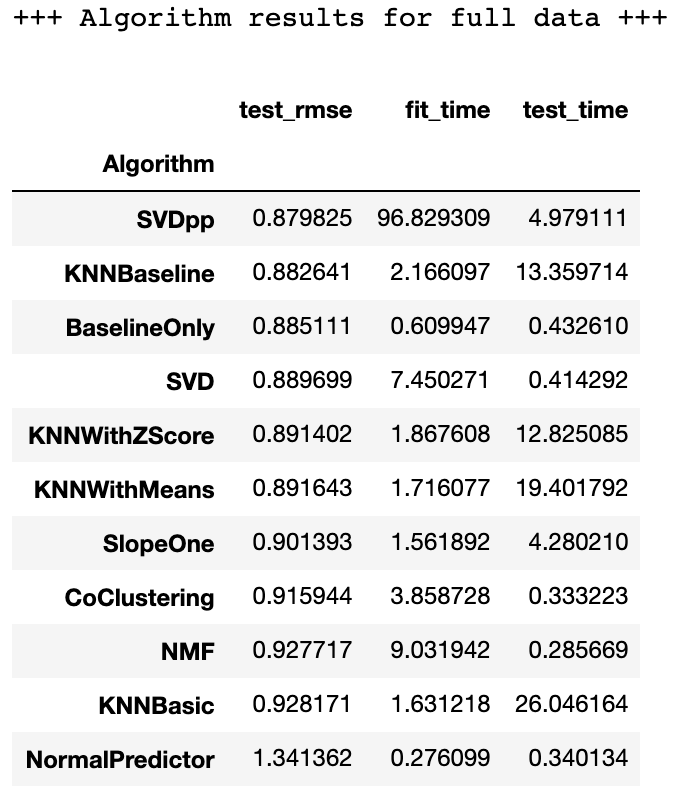 <td>
<td> 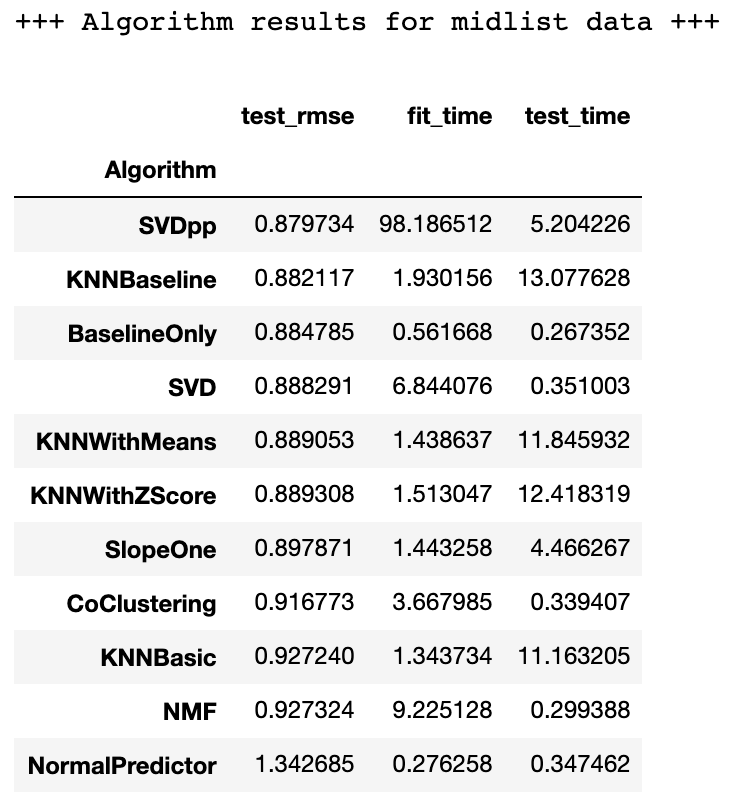 <td>
<td> 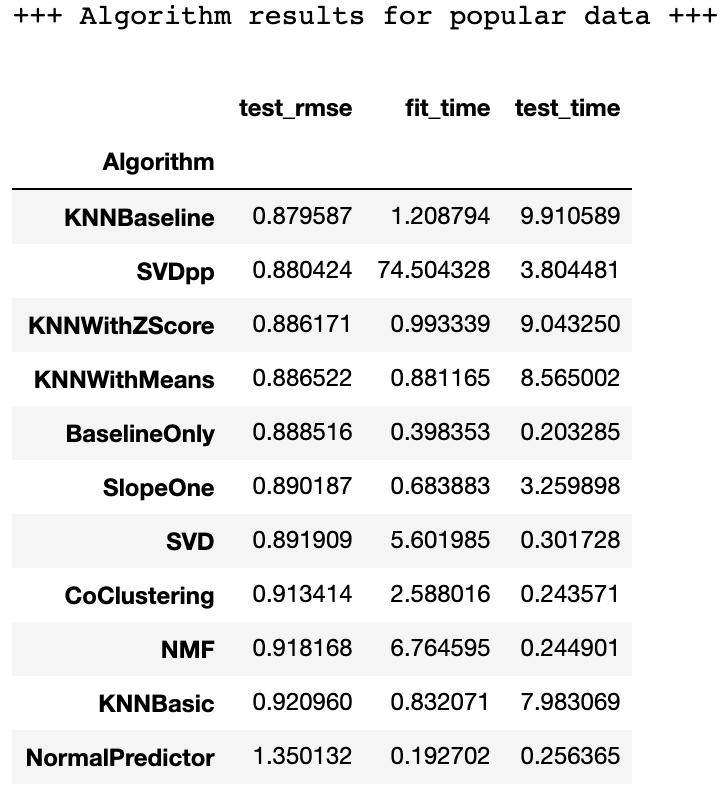 <td>
</tr><table>

Using the top rated algorithms above, I chose to run a GridSearchCV on SVDpp, KNNBaseline, BaselineOnly, and KNNWithMeans. After completing the gridsearches, I ran 10-fold cross validation on each of the tuned models and plotted the results. I was surprised to find that the KNNBaseline ultimely performed best, especially considering that the SVDpp algorithm had been a front runner initially. The SVD algorithm created by Simon Funk is used in the Netflix RS, so I had expected this to be the most accurate.


Perform gridsearch on the top 4 algorithms to tune the parameters
Using the best models, perform cross validation and plot the results
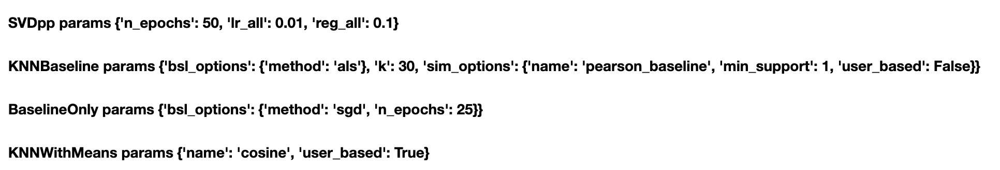
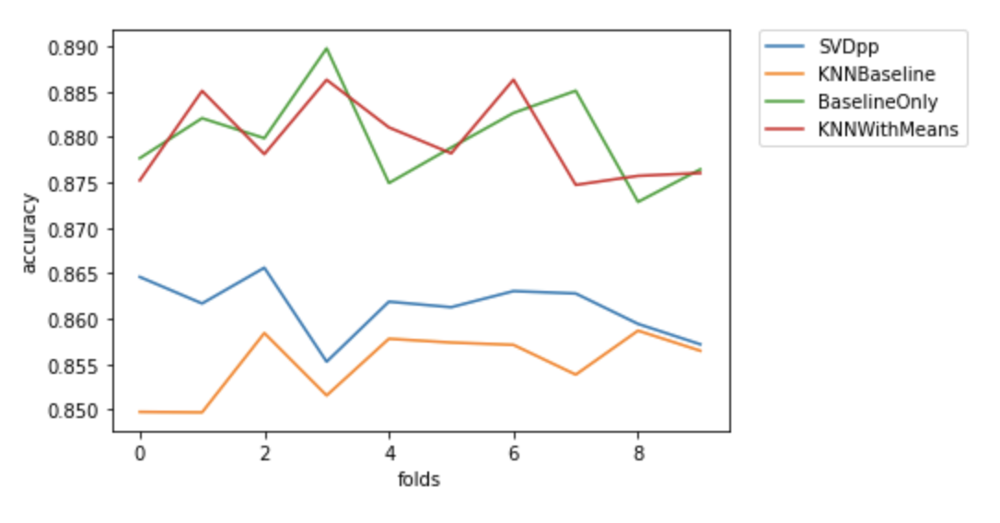

The KNNBaseline algorithm's lowest RMSE was about 0.85, much higher than the PySpark RMSE of 0.36, but the model was faster and easy to use. One downfall, though, is that the model predicts books by user so it can only be used with current readers. This is known as the 'cold start problem' because the algorithm will not provide any output until a user has built up a profile. 


In [8]:
# Use the best parameters for the lowest rmse model to run the actual recommendations
# KNNBaseline algo - the best params make this an item based CF ('user_based' = False)
sim_options = {'name': 'pearson_baseline', 'user_based': False}
bsl_options = {'method': 'als'}

algo_KNNBaseline = surprise.prediction_algorithms.knns.KNNBaseline(k = 30, sim_options = sim_options, 
                                                                   bsl_options = bsl_options, verbose=True)

In [9]:
# https://github.com/NicolasHug/Surprise/blob/master/examples/top_n_recommendations.py
"""
This module illustrates how to retrieve the top-10 items with highest rating
prediction. We first train an SVD algorithm on the MovieLens dataset, and then
predict all the ratings for the pairs (user, item) that are not in the training
set. We then retrieve the top-10 prediction for each user.
"""

from __future__ import (absolute_import, division, print_function,
                        unicode_literals)
from collections import defaultdict

from surprise import SVDpp
from surprise import Dataset


def get_top_n(predictions, n=10):
    """Return the top-N recommendation for each user from a set of predictions.
    Args:
        predictions(list of Prediction objects): The list of predictions, as
            returned by the test method of an algorithm.
        n(int): The number of recommendation to output for each user. Default
            is 10.
    Returns:
    A dict where keys are user (raw) ids and values are lists of tuples:
        [(raw item id, rating estimation), ...] of size n.
    """

    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [10]:
# Train the optimized algorithm on the dataset
trainset = data.build_full_trainset()
algo_KNNBaseline.fit(trainset)
# predict ratings for all user/item pairs that are NOT in the training set
testset = trainset.build_anti_testset()
predictions = algo_KNNBaseline.test(testset)

Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.


In [56]:
top_n = get_top_n(predictions, n = 10)

# print recommended items for each user
for uid, user_ratings in top_n.items():
    print(uid, [iid for (iid, _) in user_ratings])

1 [2686, 8390, 4315, 8083, 1778, 6089, 8323, 8903, 4811, 753]
2 [103, 65, 113, 3020, 9114, 2584, 778, 1967, 5425, 102]
4 [1778, 5438, 7839, 4328, 6943, 7473, 8559, 9727, 8675, 6508]
6 [8946, 3628, 6772, 757, 1338, 4868, 6590, 6920, 4483, 1010]
8 [8946, 8038, 4258, 3366, 5192, 6505, 8055, 6487, 6898, 6411]
9 [8332, 5491, 8880, 4894, 8714, 7264, 8423, 5972, 9243, 4296]
11 [4054, 5830, 8946, 7806, 1705, 8585, 8035, 3055, 601, 1370]
15 [70, 102, 2586, 85, 5101, 8946, 8585, 661, 6018, 4315]
18 [4291, 3719, 9819, 2291, 2980, 6425, 7909, 5214, 7734, 6617]
22 [2686, 3753, 9934, 7006, 1705, 5805, 6368, 976, 4597, 1441]
24 [9268, 889, 1291, 841, 1336, 6988, 2432, 4850, 8558, 2189]
25 [5101, 1010, 8585, 5207, 4483, 6018, 8538, 7143, 4441, 8854]
28 [5044, 9587, 8848, 8503, 4978, 6019, 3158, 8879, 9347, 6725]
32 [8946, 8585, 6590, 5055, 4228, 9452, 9214, 3111, 6498, 6547]
29 [8286, 7428, 8163, 2696, 2078, 1013, 6617, 2191, 6702, 8922]
34 [6457, 1618, 2940, 8821, 541, 7974, 9887, 3418, 2526, 6856]
4

1460 [297, 47, 87, 1055, 2975, 85, 598, 8946, 6160, 7495]
1434 [2586, 8946, 4483, 734, 4894, 524, 504, 840, 757, 6886]
1450 [1875, 3922, 776, 2835, 2931, 7562, 5477, 5400, 2370, 6158]
1465 [6446, 5756, 3099, 7910, 9887, 3078, 9483, 3423, 9104, 3392]
1468 [70, 102, 47, 296, 39, 110, 8946, 4672, 2729, 1877]
1473 [442, 740, 9308, 39, 427, 3457, 4336, 3451, 8998, 1106]
1472 [6802, 8387, 3840, 2946, 3661, 2744, 6133, 2631, 3669, 3639]
1475 [9848, 2557, 3225, 3910, 7623, 1991, 3922, 8177, 2631, 6133]
1476 [9472, 2078, 3629, 4832, 4478, 8048, 8850, 8879, 7428, 534]
1449 [6089, 8875, 2459, 9848, 2482, 1781, 2878, 7878, 3444, 4280]
1478 [980, 1653, 9483, 9382, 3840, 9372, 6967, 6968, 3669, 9197]
1482 [8585, 4483, 504, 7143, 3395, 8161, 8286, 8677, 4411, 7623]
1488 [4054, 9773, 7054, 2980, 6166, 7763, 6802, 9389, 7910, 3078]
1417 [5493, 3444, 2096, 4868, 7734, 1611, 7833, 2021, 1456, 9534]
1489 [70, 297, 9114, 102, 47, 50, 184, 219, 1055, 181]
1474 [2686, 3753, 70, 103, 9114, 102, 47, 87, 219, 1

2641 [337, 6351, 5425, 7254, 958, 5101, 8946, 8882, 6772, 2729]
2643 [4891, 5907, 5575, 4894, 881, 6505, 7054, 5681, 3577, 2863]
2644 [4919, 9301, 9673, 4677, 8387, 2268, 7878, 7109, 5624, 47]
2046 [39, 135, 110, 8946, 6772, 1597, 1199, 5175, 7569, 4228]
2645 [7254, 7639, 8946, 6772, 5207, 976, 601, 998, 4258, 6505]
2647 [4, 4043, 2142, 2716, 8946, 5508, 6772, 8818, 6375, 6524]
2650 [2686, 3753, 964, 36, 200, 372, 7538, 7254, 2586, 488]
2652 [7630, 4112, 7089, 6397, 9397, 2501, 4368, 6760, 5853, 2446]
2648 [3020, 1967, 1380, 8329, 2142, 4149, 5730, 8995, 5563, 3451]
2654 [8946, 8420, 7504, 3628, 4868, 3395, 6009, 3572, 8585, 2526]
2657 [3900, 2266, 6089, 6920, 2864, 8930, 6590, 8831, 6547, 2507]
2662 [516, 8946, 7495, 8818, 339, 6620, 734, 3232, 4894, 524]
2663 [1010, 8946, 8585, 6590, 6920, 6361, 7143, 3520, 7054, 757]
2667 [9758, 9347, 1013, 7734, 7378, 8738, 9372, 5779, 4735, 7060]
2670 [4054, 80, 8946, 5508, 7806, 6772, 2729, 8332, 4885, 8585]
2671 [3013, 8069, 9069, 9887, 6446, 31

3732 [161, 857, 3457, 8818, 738, 4301, 3321, 4441, 3120, 5346]
3721 [8038, 6400, 4898, 6487, 4722, 2863, 8823, 9707, 9247, 7302]
3687 [3753, 70, 337, 102, 47, 87, 350, 4, 1380, 7254]
3735 [4735, 8203, 1243, 7880, 6592, 4146, 8842, 9849, 5008, 2022]
3565 [524, 1781, 9104, 4554, 4478, 5510, 565, 4868, 6397, 6645]
3741 [8946, 1705, 4699, 3710, 8538, 1554, 5879, 7027, 7014, 9732]
3696 [1422, 9378, 2223, 4026, 9452, 8903, 9389, 6669, 3099, 4730]
3743 [85, 274, 463, 779, 6920, 109, 709, 229, 6772, 4862]
3541 [7994, 7855, 3111, 8647, 1545, 5841, 8940, 2684, 1193, 4080]
3745 [1010, 4769, 6375, 7630, 2266, 6259, 7606, 4894, 1199, 3710]
3746 [757, 2586, 6920, 1010, 4154, 70, 7254, 6361, 3395, 25]
3717 [9526, 9698, 447, 4242, 5515, 9397, 9956, 4868, 7341, 5560]
3212 [7239, 8323, 9793, 7137, 3225, 2864, 9480, 5980, 2907, 3289]
3747 [337, 3628, 3431, 8161, 8286, 9389, 6446, 9383, 5619, 7873]
3752 [8818, 8585, 9773, 8423, 9452, 9863, 6131, 3059, 9359, 3115]
3749 [6902, 1833, 3692, 762, 2802, 1632, 2

4840 [8423, 3059, 9359, 4832, 7433, 4744, 6218, 6856, 7661, 5995]
4839 [7054, 5681, 9587, 5898, 7763, 8149, 8503, 3762, 1907, 3078]
4841 [70, 7254, 9308, 7639, 161, 4483, 6920, 7333, 3472, 3628]
4824 [2975, 1010, 5658, 8946, 5508, 6590, 6920, 6361, 4361, 976]
4443 [3489, 2039, 8946, 4228, 7710, 7817, 5752, 3695, 4881, 4054]
6840 [740, 5563, 8156, 8946, 4336, 7495, 6772, 4885, 3628, 5192]
4814 [9308, 512, 4483, 2963, 3055, 9773, 5378, 561, 8880, 4939]
4784 [2142, 8946, 5508, 1705, 7495, 6772, 1961, 8332, 8585, 2963]
4847 [2586, 3244, 8038, 6375, 4090, 7630, 9689, 7239, 8233, 7733]
4848 [1055, 54, 1877, 94, 121, 103, 532, 4811, 1597, 2127]
4849 [2686, 3753, 70, 964, 103, 102, 47, 50, 87, 184]
4852 [8946, 2869, 8585, 7654, 5691, 9758, 7143, 5175, 2980, 9452]
4853 [6351, 9114, 7254, 8035, 998, 3482, 9803, 1327, 4494, 5181]
4834 [4054, 5115, 8946, 5508, 5283, 7495, 1788, 8035, 339, 1146]
4846 [1789, 8323, 3744, 3058, 5788, 4411, 4351, 7849, 8088, 5336]
4831 [8856, 5413, 8795, 8946, 3520, 55

In [60]:
type(top_n)

collections.defaultdict

In [63]:
# view ratings for user 2
books10k = books10k[['book_id', 'goodreads_book_id', 
               'authors', 'original_publication_year', 'original_title',
               'title', 'average_rating']]

In [65]:
ratings2 = pd.DataFrame(ratings10k[ratings10k['user_id'] == 2])
print(ratings2)

    user_id  book_id  rating
1         2     4081       4
2         2      260       5
3         2     9296       5
4         2     2318       3
5         2       26       4
6         2      315       3
7         2       33       4
8         2      301       5
9         2     2686       5
10        2     3753       5
11        2     8519       5


In [66]:
ratings2 = pd.merge(ratings2, books10k, how = 'left', on = 'book_id')
print(ratings2)

    user_id  book_id  rating  goodreads_book_id  \
0         2     4081       4                231   
1         2      260       5               4865   
2         2     9296       5               4887   
3         2     2318       3                998   
4         2       26       4                968   
5         2      315       3               4894   
6         2       33       4                930   
7         2      301       5               4900   
8         2     2686       5               4898   
9         2     3753       5                 10   
10        2     8519       5             401876   

                                  authors  original_publication_year  \
0                               Tom Wolfe                     2004.0   
1                           Dale Carnegie                     1936.0   
2                Alice  Miller, Ruth Ward                     1979.0   
3     Thomas J. Stanley, William D. Danko                     1995.0   
4                          

In [69]:
# view recommendations for user 2
user2 = pd.DataFrame(top_n[2])
user2.columns = ['book_id', 'pred_rating']
user2 = pd.merge(user2, books10k, how = 'left', on = 'book_id')
user2

,book_id,pred_rating,goodreads_book_id,authors,original_publication_year,original_title,title,average_rating
0,103,5,7126,"Alexandre Dumas, Robin Buss",1844.0,Le Comte de Monte-Cristo,The Count of Monte Cristo,4.21
1,65,5,4981,Kurt Vonnegut Jr.,1969.0,"Slaughterhouse-Five, or The Children's Crusade...",Slaughterhouse-Five,4.06
2,113,5,168668,Joseph Heller,1961.0,Catch-22,Catch-22,3.98
3,3020,5,7723,"Franz Kafka, Jason Baker, Donna Freed",1915.0,Die Verwandlung und andere Erzählungen,The Metamorphosis and Other Stories,4.01
4,9114,5,132314,Edgar Allan Poe,1849.0,The Complete Tales and Poems of Edgar Allan Poe,The Complete Tales and Poems,4.48
5,2584,5,393199,George Orwell,1933.0,Down and Out in Paris and London,Down and Out in Paris and London,4.10
6,778,5,30597,"Victor Hugo, Walter J. Cobb",1831.0,Notre-Dame de Paris,The Hunchback of Notre-Dame,3.97
7,1967,5,30659,"Marcus Aurelius, Martin Hammond, Diskin Clay",180.0,Τὰ εἰς ἑαυτόν,Meditations,4.20
8,5425,5,30672,"Arthur Koestler, Daphne Hardy",1940.0,Sonnenfinsternis,Darkness at Noon,4.06
9,102,5,19543,Maurice Sendak,1963.0,Where the Wild Things Are,Where the Wild Things Are,4.22


### Content Filtering
Content filtering uses cosine similarity to map attributes (in my case, text) in order to determine which items are most similar to one another. Because of this, there is no way to measure the accuracy of the models and the results are more subjective. However, I do have strong domain knowledge in this area because I used to manage a bookstore and am still fairly well read, so I was able to identify a model that I thought was better than the others. Of course, this is personal preference.


#### Tfidf and Count Vectorization
Here, features are extracted using term frequency-inverse document frequency (tfidf) or count vectorization. Using cosine similarity, both count and tfidf seem viable but tfidf might be more accurate since it is better at recommending the same authors and series.


### Extract features from text

In [26]:
pd.set_option('display.max_columns', 100)
ds = pd.read_csv('Data/reviews10k_grouped_full.csv')

# for tf-idf
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer()
tfidf_rev = tfidf_vectorizer.fit_transform((ds['full_text']))

# for count
from sklearn.feature_extraction.text import CountVectorizer
count_vectorizer = CountVectorizer()
count_rev = count_vectorizer.fit_transform((ds['full_text']))

In [72]:
ds.head()

,book_id,goodreads_book_id,best_book_id,work_id,books_count,isbn,isbn13,original_publication_year,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,authors_y,original_title_y,review_text,full_text
0,1,2767052,2767052,2792775,272,439023483,9.780439e+12,2008.0,"The Hunger Games (The Hunger Games, #1)",eng,4.34,4780653,4942365,155254,66715,127936,560092,1481305,2706317,Suzanne Collins,The Hunger Games,I cracked and finally picked this up. Very enj...,"2008.0 The Hunger Games (The Hunger Games, #1)..."
1,2,3,3,4640799,491,439554934,9.780440e+12,1997.0,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.44,4602479,4800065,75867,75504,101676,455024,1156318,3011543,"J.K. Rowling, Mary GrandPré",Harry Potter and the Philosopher's Stone,Tuve el gusto de leerlo antes de que saliera l...,1997.0 Harry Potter and the Sorcerer's Stone (...
2,3,41865,41865,3212258,226,316015849,9.780316e+12,2005.0,"Twilight (Twilight, #1)",en-US,3.57,3866839,3916824,95009,456191,436802,793319,875073,1355439,Stephenie Meyer,Twilight,"If I was 15, I would have LOVED this. It wasn'...","2005.0 Twilight (Twilight, #1) en-US Stephenie..."
3,4,2657,2657,3275794,487,61120081,9.780061e+12,1960.0,To Kill a Mockingbird,eng,4.25,3198671,3340896,72586,60427,117415,446835,1001952,1714267,Harper Lee,To Kill a Mockingbird,"Still relevant and beautiful.,R.I.P. Ms. Harpe...",1960.0 To Kill a Mockingbird eng Harper Lee To...
4,5,4671,4671,245494,1356,743273567,9.780743e+12,1925.0,The Great Gatsby,eng,3.89,2683664,2773745,51992,86236,197621,606158,936012,947718,F. Scott Fitzgerald,The Great Gatsby,I read this classic twice in high school. Its ...,1925.0 The Great Gatsby eng F. Scott Fitzgeral...


In [73]:
ds[ds['original_title_y'] == 'The Name of the Wind']

,book_id,goodreads_book_id,best_book_id,work_id,books_count,isbn,isbn13,original_publication_year,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,authors_y,original_title_y,review_text,full_text
191,192,186074,186074,2502879,123,075640407X,9.780756e+12,2007.0,The Name of the Wind (The Kingkiller Chronicle...,eng,4.55,400101,449372,28631,5605,8582,28480,95470,311235,Patrick Rothfuss,The Name of the Wind,Brilliant. Would highly recommend this and the...,2007.0 The Name of the Wind (The Kingkiller Ch...


In [74]:
#Choose book by inserting goodreads_book_id
g = 186074 
index = np.where(ds['goodreads_book_id'] == g)[0][0]
read_book = ds.iloc[[index]]

### Content based RS with TfidfVectorizer and CountVectorizer

In [75]:
from sklearn.metrics.pairwise import cosine_similarity
book_tfidf = tfidf_vectorizer.transform(read_book['full_text'])
cos_similarity_tfidf = map(lambda x: cosine_similarity(book_tfidf, x), tfidf_rev)
output = list(cos_similarity_tfidf)

In [76]:
from sklearn.metrics.pairwise import cosine_similarity
book_count = count_vectorizer.transform(read_book['full_text'])
cos_similarity_countv = map(lambda x: cosine_similarity(book_count, x), count_rev)
output2 = list(cos_similarity_countv)

In [77]:
def get_recommendation(top, ds, scores):
  recommendation = pd.DataFrame(columns = ['goodreads_book_id', 'authors', 'title', 'score'])
  count = 0
  for i in top:
      recommendation.at[count, 'goodreads_book_id'] = ds.iloc[i, 2]
      recommendation.at[count, 'authors'] = ds.iloc[i, 19]
      recommendation.at[count, 'title'] = ds.iloc[i, 8]
      recommendation.at[count, 'score'] =  scores[count]
      count += 1
  return recommendation

### Top recommendations

In [78]:
count

,goodreads_book_id,authors,title,score
0,186074,Patrick Rothfuss,The Name of the Wind (The Kingkiller Chronicle...,1
1,1215032,Patrick Rothfuss,"The Wise Man's Fear (The Kingkiller Chronicle,...",0.977828
2,13496,George R.R. Martin,"A Game of Thrones (A Song of Ice and Fire, #1)",0.869714
3,25451852,Jonathan Renshaw,"Dawn of Wonder (The Wakening, #1)",0.861367
4,16299991,Morgan Rice,"A Quest of Heroes (The Sorcerer's Ring, #1)",0.856946
5,6288,Cormac McCarthy,The Road,0.855277
6,13616278,Miles Cameron,"The Red Knight (The Traitor Son Cycle, #1)",0.854879
7,210329,Susan Cooper,"The Dark Is Rising (The Dark is Rising, #2)",0.854666
8,28802599,"Paul Pen, Simon Bruni",The Light of the Fireflies,0.854013
9,228665,Robert Jordan,"The Eye of the World (Wheel of Time, #1)",0.853917


In [79]:
# for count
top = sorted(range(len(output2)), key=lambda i: output2[i], reverse=True)[:10]
list_scores = [output2[i][0][0] for i in top]
get_recommendation(top, ds, list_scores)

,goodreads_book_id,authors,title,score
0,186074,Patrick Rothfuss,The Name of the Wind (The Kingkiller Chronicle...,1
1,1215032,Patrick Rothfuss,"The Wise Man's Fear (The Kingkiller Chronicle,...",0.992984
2,13569581,Anthony Ryan,"Blood Song (Raven's Shadow, #1)",0.988375
3,25451852,Jonathan Renshaw,"Dawn of Wonder (The Wakening, #1)",0.987859
4,3227063,Brent Weeks,"The Way of Shadows (Night Angel, #1)",0.986904
5,7235533,Brandon Sanderson,"The Way of Kings (The Stormlight Archive, #1)",0.985759
6,77197,Robin Hobb,"Assassin's Apprentice (Farseer Trilogy, #1)",0.985717
7,944073,Joe Abercrombie,"The Blade Itself (The First Law, #1)",0.984065
8,43889,Terry Goodkind,"Wizard's First Rule (Sword of Truth, #1)",0.983997
9,18144124,Terry Hayes,"I Am Pilgrim (Pilgrim, #1)",0.98395


## Conclusions

### Collaborative Filtering
I created 2 user-based Collaborative Filtering RS via PySpark and Surprise. PySpark, while slower, had a much better RMSE rate and would thus be my preferred model if I wanted to recommend books by user. PearsonR was the only item-based Collaborative Filtering RS that I built but I was satisfied with the results. If I were to continue with this project, I would further investigate item-based models and look for an alternative method of evaluation.


### Content Filtering
This portion of the project was most interesting to me because it allowed me to conduct text analysis. Looking at the results of my models, I believe that the tfidf model is most relevant but, as I indicated above, that is a matter of personal preference. It might be interesting to do additional research on the review text for each book, even conducting sentiment analysis to determine what percentage of reviews are positive vs. negative. My interaction with the data led me to believe that most people write positive reviews, but it could be helpful to identify the negative reviews and use those to negatively weight the books for recommendations. I could also conduct a live survey for users to try out the content filtering models and rate them, allowing me to better measure their success. One final thought for future investigation involves image classification. Goodreads provides a url to show the cover of most of its books, so it could be interesting to see if a model could be trained on the images to predict genre or even recommend titles.

In all, I felt like this was a good choice for a practicum project. The problem was interesting to me and also advanced enough to challenge me to learn more about text analysis and machine learning algorithms used in recommendation engines. The data did involve some cleaning and prep, especially since I had to change datasets in Week 3, but it was not so time consuming that I did not get to spend adequate time on building and tuning the models. I was also able to improve my Python skills and learned how to use several packages that were new to me (Surprise, pandas_profiling, PySpark - I had limited experience).


## References:
* https://heartbeat.fritz.ai/recommender-systems-with-python-part-i-content-based-filtering-5df4940bd831
* https://github.com/ArmandDS/jobs_recommendations/blob/master/job_analysis_content_recommendation.ipynb
* https://github.com/MengtingWan/goodreads
* https://github.com/NicolasHug/Surprise/blob/master/examples/top_n_recommendations.py
* https://github.com/nikitaa30/Content-based-Recommender-System/blob/master/recommender_system.py
* https://github.com/susanli2016/Machine-Learning-with-Python/blob/master/Recommender%20Systems%20-%20The%20Fundamentals.ipynb
* https://medium.com/@armandj.olivares/building-nlp-content-based-recommender-systems-b104a709c042
* https://medium.com/@chhavi.saluja1401/recommendation-systems-made-simple-b5a79cac8862
* https://stackabuse.com/creating-a-simple-recommender-system-in-python-using-pandas/
* https://stackoverflow.com/questions/39303912/tfidfvectorizer-in-scikit-learn-valueerror-np-nan-is-an-invalid-document
* https://towardsdatascience.com/collaborative-filtering-based-recommendation-systems-exemplified-ecbffe1c20b1
* https://towardsdatascience.com/how-did-we-build-book-recommender-systems-in-an-hour-the-fundamentals-dfee054f978e
* https://towardsdatascience.com/introduction-to-recommender-systems-6c66cf15ada
* https://towardsdatascience.com/my-journey-to-building-book-recommendation-system-5ec959c41847
* https://towardsdatascience.com/recommendation-systems-models-and-evaluation-84944a84fb8e
* https://towardsdatascience.com/various-implementations-of-collaborative-filtering-100385c6dfe0
* https://www.kaggle.com/robottums/hybrid-recommender-systems-with-surprise
* https://www.kaggle.com/vchulski/tutorial-collaborative-filtering-with-pyspark
* https://www.tutorialspoint.com/change-data-type-for-one-or-more-columns-in-pandas-dataframe-1
* Mengting Wan, Julian McAuley, "Item Recommendation on Monotonic Behavior Chains", in RecSys'18.
* Mengting Wan, Rishabh Misra, Ndapa Nakashole, Julian McAuley, "Fine-Grained Spoiler Detection from Large-Scale Review Corpora", in ACL'19.
